<a href="https://colab.research.google.com/github/aderiye6/desktop_application/blob/main/Combined_Predictive_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!pip install ydata_profiling
!pip install utils
!pip install flaml
!pip install shap


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.9/357.9 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 11.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 24.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 25.9 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=f09fc802051d39c4f04453927d1748be38072706bb83546a02d64a1712e3a29f
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.13.1
    Uninstalling seaborn-0.13.1:
      Successfully uninstalled seaborn-0.13.1
  Preparing metadata (setup.py) ... done
  Created wheel for utils: filename=utils-1.0.2-py2.py3-no

In [7]:
# %% import libraries
import numpy as np
import pandas as pd
from sklearn.metrics import classification_report
from ydata_profiling import ProfileReport
#from utils import find_project_root

from sklearn.feature_selection import RFECV
from sklearn.model_selection import train_test_split
from lightgbm import LGBMClassifier
import xgboost
from flaml import AutoML
from datetime import datetime

from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import shap

plt.rcParams["figure.figsize"] = (4,4)
%matplotlib inline

import random
random.seed(42)

import warnings
warnings.filterwarnings("ignore")

In [8]:
# %% read data
#project_root = find_project_root()
#data_dir = project_root / "data"
insurance_data = pd.read_csv("home_insurance.csv")
#insurance_data = pd.read_csv(data_dir / "Home Insurance Dataset2.csv")

In [9]:
insurance_data.head()

,QUOTE_DATE,COVER_START,CLAIM3YEARS,P1_EMP_STATUS,P1_PT_EMP_STATUS,BUS_USE,CLERICAL,AD_BUILDINGS,RISK_RATED_AREA_B,SUM_INSURED_BUILDINGS,...,HP3_ADDON_PRE_REN,HP3_ADDON_POST_REN,MTA_FLAG,MTA_FAP,MTA_APRP,MTA_DATE,LAST_ANN_PREM_GROSS,POL_STATUS,i,Police
0,11/22/2007,22/11/2007,N,R,NaN,N,NaN,Y,19.0,1000000.0,...,N,N,N,NaN,NaN,NaN,274.81,Lapsed,1,P000001
1,11/22/2007,01/01/2008,N,E,NaN,Y,N,Y,25.0,1000000.0,...,N,N,Y,308.83,-9.27,NaN,308.83,Live,2,P000002
2,11/23/2007,23/11/2007,N,E,NaN,N,NaN,N,NaN,0.0,...,N,N,Y,52.65,52.65,03/11/2010,52.65,Live,3,P000003
3,11/23/2007,12/12/2007,N,R,NaN,N,NaN,N,NaN,0.0,...,N,N,N,NaN,NaN,NaN,54.23,Live,4,P000004
4,11/22/2007,15/12/2007,N,R,NaN,N,NaN,Y,5.0,1000000.0,...,N,N,N,NaN,NaN,NaN,244.58,Live,5,P000005


In [10]:
insurance_data.iloc[28].isna().sum()

57

In [11]:
## %%
profile = ProfileReport(insurance_data, title="Home Insurance Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [52]:
profile.to_file("home_insurance_profiling_report.pdf")


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
# %% [markdown]
# R = Retired,
# E = Employed,
# N = Not Available,
# H = House person,
# S = Student ,
# U = Unemployed.
#
# These are the only employment statuses that we are aware of and they also make up the bulk of the dataset. Hence, we keep these and remove the rest.

# %%
employment_status = ['R', 'E', 'H', 'S', 'U']
clean_data = insurance_data[insurance_data['P1_EMP_STATUS'].isin(employment_status)]
print(clean_data.shape)

(188074, 66)


In [13]:
clean_data.dropna(subset=["COVER_START"], how="all",axis=0, inplace=True)
clean_data = clean_data.reset_index(drop=True)
print(clean_data.shape)

(188074, 66)


In [14]:
clean_data.drop(columns=["QUOTE_DATE","P1_PT_EMP_STATUS","MTA_DATE","CLERICAL","MTA_APRP","MTA_FAP","i","Police",
                       "CAMPAIGN_DESC","PAYMENT_FREQUENCY"],inplace=True)

In [15]:
clean_data.isnull().sum()

COVER_START                   0
CLAIM3YEARS                   0
P1_EMP_STATUS                 0
BUS_USE                       0
AD_BUILDINGS                  0
RISK_RATED_AREA_B         47702
SUM_INSURED_BUILDINGS         0
NCD_GRANTED_YEARS_B           0
AD_CONTENTS                   0
RISK_RATED_AREA_C          8687
SUM_INSURED_CONTENTS          0
NCD_GRANTED_YEARS_C           0
CONTENTS_COVER                0
BUILDINGS_COVER               0
SPEC_SUM_INSURED              0
SPEC_ITEM_PREM                0
UNSPEC_HRP_PREM               0
P1_DOB                        0
P1_MAR_STATUS                 0
P1_POLICY_REFUSED             0
P1_SEX                        0
APPR_ALARM                    0
APPR_LOCKS                    0
BEDROOMS                      0
ROOF_CONSTRUCTION             0
WALL_CONSTRUCTION             0
FLOODING                      0
LISTED                        0
MAX_DAYS_UNOCC                0
NEIGH_WATCH                   0
OCC_STATUS                    0
OWNERSHI

In [16]:
clean_data.describe()

,RISK_RATED_AREA_B,SUM_INSURED_BUILDINGS,NCD_GRANTED_YEARS_B,RISK_RATED_AREA_C,SUM_INSURED_CONTENTS,NCD_GRANTED_YEARS_C,SPEC_SUM_INSURED,SPEC_ITEM_PREM,UNSPEC_HRP_PREM,BEDROOMS,ROOF_CONSTRUCTION,WALL_CONSTRUCTION,LISTED,MAX_DAYS_UNOCC,OWNERSHIP_TYPE,PAYING_GUESTS,PROP_TYPE,YEARBUILT,LAST_ANN_PREM_GROSS
count,140372.000000,188074.000000,188074.000000,179387.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000,188074.000000
mean,10.270574,779358.124993,4.483384,9.048487,47836.410136,5.496778,329.329392,2.504246,5.658642,2.780666,11.020651,14.978030,2.995667,8.450286,7.638344,0.001095,10.214245,1944.992710,186.870486
std,8.449691,414680.542491,2.673006,7.621426,10706.458075,1.775969,1333.244367,10.655611,10.256210,0.801230,0.886130,0.870693,0.083633,15.203059,2.524198,0.033077,8.945654,28.892631,99.451596
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1749.000000,-1152.680000
25%,3.000000,1000000.000000,3.000000,3.000000,50000.000000,6.000000,0.000000,0.000000,0.000000,2.000000,11.000000,15.000000,3.000000,0.000000,8.000000,0.000000,2.000000,1920.000000,123.720000
50%,9.000000,1000000.000000,6.000000,7.000000,50000.000000,6.000000,0.000000,0.000000,0.000000,3.000000,11.000000,15.000000,3.000000,0.000000,8.000000,0.000000,10.000000,1946.000000,177.470000
75%,14.000000,1000000.000000,6.000000,13.000000,50000.000000,6.000000,0.000000,0.000000,12.450000,3.000000,11.000000,15.000000,3.000000,30.000000,8.000000,0.000000,18.000000,1960.000000,235.080000
max,98.000000,1000000.000000,9.000000,98.000000,100000.000000,9.000000,47500.000000,973.530000,162.610000,7.000000,99.000000,99.000000,5.000000,181.000000,18.000000,1.000000,53.000000,2000.000000,4631.860000


In [17]:
# # %%
# # remove distinct columns
# distinct_cols = ['i', 'Police', 'CAMPAIGN_DESC', 'PAYMENT_FREQUENCY']
# cols_to_keep = [col for col in clean_data.columns if col not in distinct_cols]
# clean_data = clean_data[cols_to_keep]
# print(clean_data.shape)

In [ ]:
# # # %%
profile = ProfileReport(clean_data, title="Home Insurance Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
def create_category_column(df, column_name, bins, labels):
    # Define the current year
    current_year = datetime(2013, 1, 1).year

    # Convert the specified column to datetime
    df[column_name] = pd.to_datetime(df[column_name], errors='coerce')

    age = current_year - df[column_name].dt.year

    # Create the category based on the bins and labels
    category = pd.cut(age, bins=bins, labels=labels, right=False)

    # Return the modified DataFrame
    category = category.astype('category').cat.codes
    return category

In [ ]:
# Convert DOB to datetime and calculate Age
clean_data['P1_DOB'] = pd.to_datetime(clean_data['P1_DOB'],dayfirst=True)
current_year = datetime(2013, 1, 1).year # the year of the most recent quote is 2012. Using 2013 to account for all months in 2012.
age = current_year - clean_data['P1_DOB'].dt.year

# Define and create Age Groups
bins = [0, 25, 50, 75, 100]
labels = ['0-25', '26-50', '51-75', '76+']
age_groups = pd.cut(age, bins=bins, labels=labels, right=False)

# Define and create Cover start Groups
clean_data['COVER_START'] = pd.to_datetime(clean_data['COVER_START'],dayfirst=True)
age = datetime(2013, 1, 1).year - clean_data['P1_DOB'].dt.year

bins = [0, 1, 5, 10, 20]
labels = ['0-1', '2-5', '6-10', '10+']
coverage_years = pd.cut(age, bins=bins, labels=labels, right=False)

# DRY -> Don't Repeat Yourself

In [ ]:
# Convert Age Groups to an ordinal variable
clean_data['age_groups'] = create_category_column(df=clean_data, column_name='P1_DOB', bins=[0, 25, 50, 75, 100],  labels=['0-25', '26-50', '51-75', '76+'])
clean_data['coverage_groups'] = create_category_column(df=clean_data, column_name='COVER_START', bins=[0, 1, 5, 10, 20],  labels=['0-1', '2-5', '6-10', '10+'])
# clean_data['quote_groups'] = create_category_column(df=clean_data, column_name='QUOTE_DATE', bins=[0, 1, 2, 3, 7],  labels=['0-1', '2-3', '4-5', '6+'])
# clean_data['mta_groups'] = create_category_column(df=clean_data, column_name='MTA_DATE', bins=[0, 1, 2, 3, 7],  labels=['0-1', '2-3', '4-5', '6+'])
cols_to_keep = [col for col in clean_data.columns if col not in ['P1_DOB', 'COVER_START', 'QUOTE_DATE', 'MTA_DATE']]
clean_data = clean_data[cols_to_keep]
clean_data.head()

In [ ]:
clean_data["CLAIM3YEARS"].value_counts()

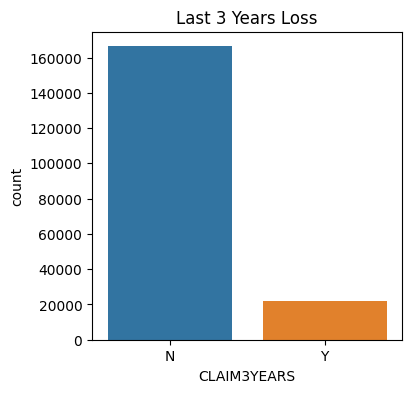

In [ ]:
sns.countplot(clean_data, x="CLAIM3YEARS")
plt.title("Last 3 Years Loss");

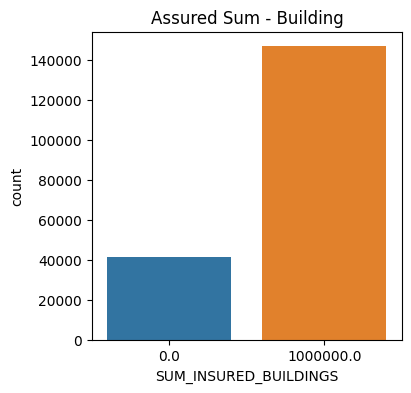

In [ ]:
sns.countplot(clean_data, x="SUM_INSURED_BUILDINGS")
plt.title("Assured Sum - Building");

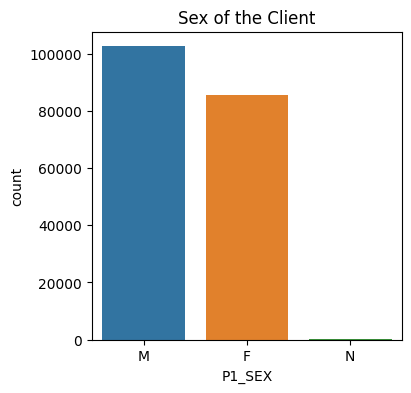

In [ ]:
sns.countplot(clean_data, x="P1_SEX")
plt.title("Sex of the Client");

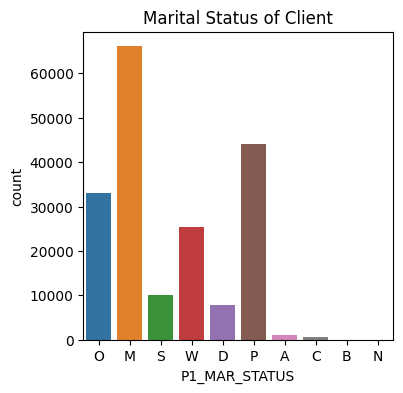

In [ ]:
sns.countplot(clean_data, x="P1_MAR_STATUS")
plt.title("Marital Status of Client");

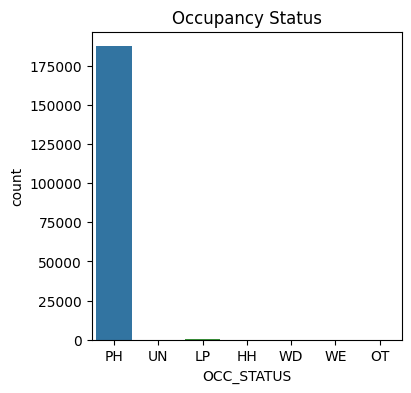

In [ ]:
sns.countplot(clean_data, x="OCC_STATUS")
plt.title("Occupancy Status");

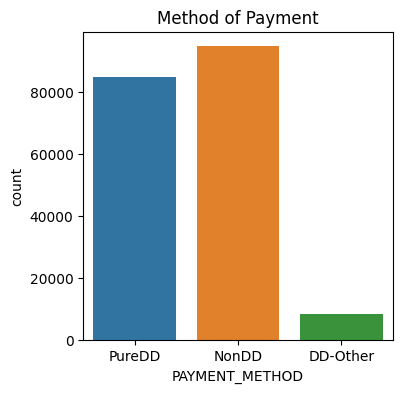

In [ ]:
sns.countplot(clean_data, x="PAYMENT_METHOD")
plt.title("Method of Payment");

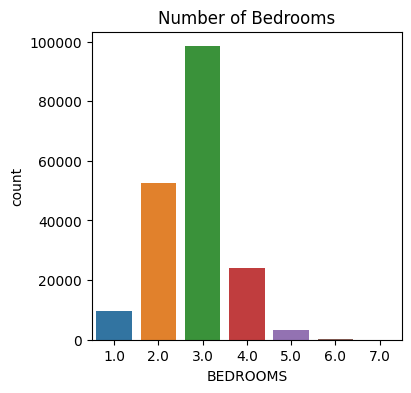

In [ ]:
sns.countplot(clean_data, x="BEDROOMS")
plt.title("Number of Bedrooms");

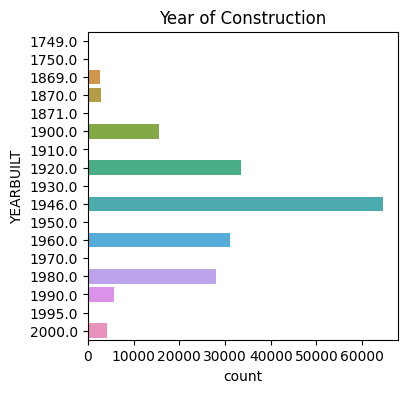

In [ ]:
sns.countplot(clean_data, y="YEARBUILT")
plt.title("Year of Construction");

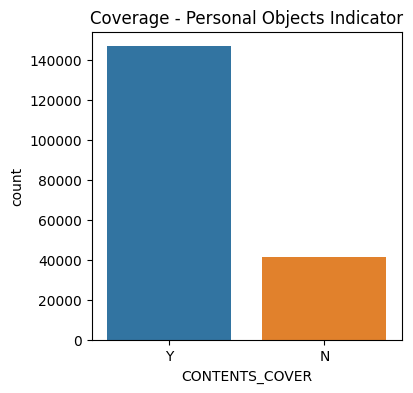

In [ ]:
sns.countplot(clean_data, x="CONTENTS_COVER")
plt.title("Coverage - Personal Objects Indicator");

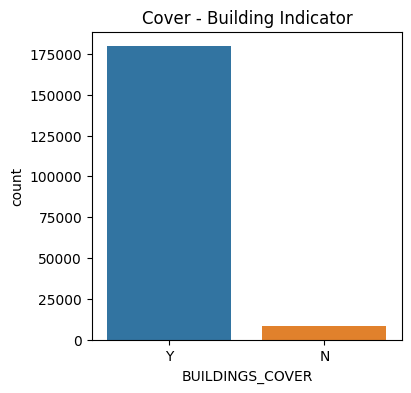

In [ ]:
sns.countplot(clean_data, x="BUILDINGS_COVER")
plt.title("Cover - Building Indicator");

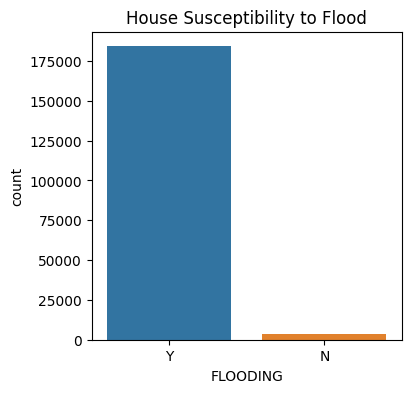

In [ ]:
sns.countplot(clean_data, x="FLOODING")
plt.title("House Susceptibility to Flood");

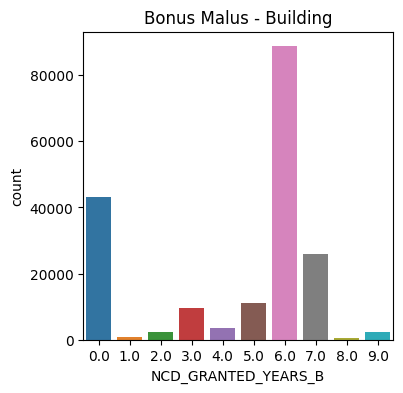

In [ ]:
sns.countplot(clean_data, x="NCD_GRANTED_YEARS_B")
plt.title("Bonus Malus - Building");

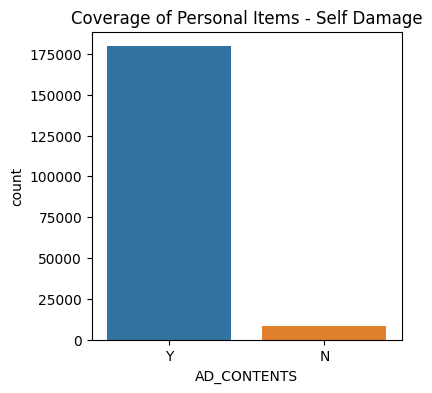

In [ ]:
sns.countplot(clean_data, x="AD_CONTENTS")
plt.title("Coverage of Personal Items - Self Damage");

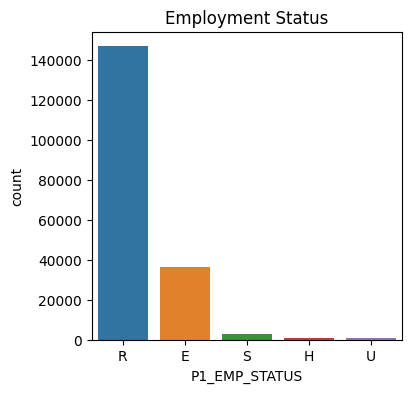

In [ ]:
sns.countplot(clean_data, x="P1_EMP_STATUS")
plt.title("Employment Status");

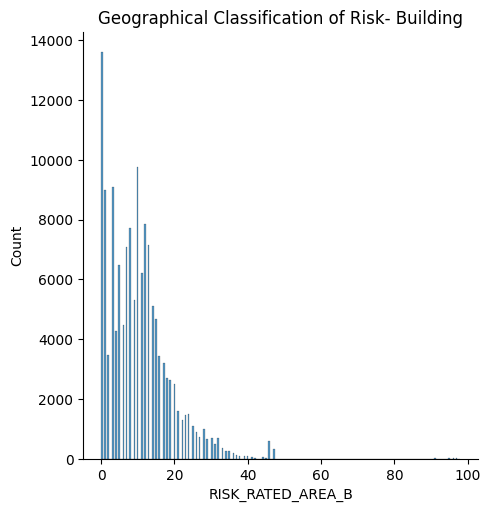

In [ ]:
sns.displot(clean_data, x="RISK_RATED_AREA_B")
plt.title("Geographical Classification of Risk- Building");

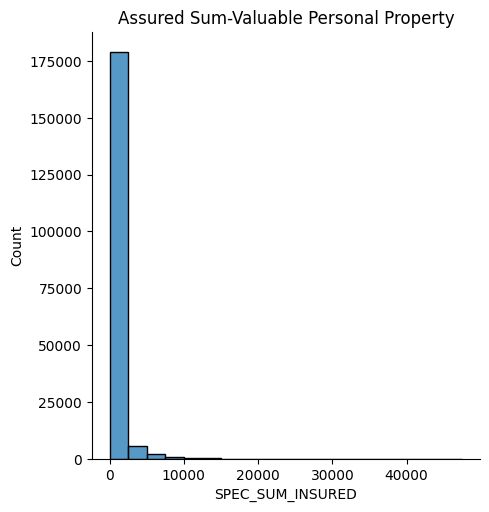

In [ ]:
sns.displot(clean_data, x="SPEC_SUM_INSURED")
plt.title("Assured Sum-Valuable Personal Property");

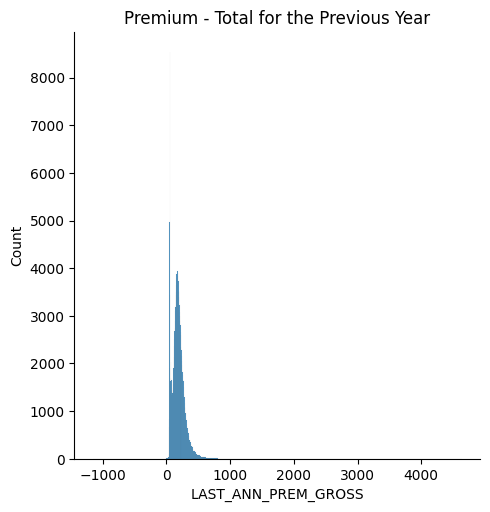

In [ ]:
sns.displot(clean_data, x="LAST_ANN_PREM_GROSS")
plt.title("Premium - Total for the Previous Year");

In [ ]:
numeric = clean_data.select_dtypes(include=np.number)

In [ ]:
# %%
def convert_categorical_and_boolean_to_numerical(df):
    # Create a copy of the DataFrame to avoid modifying the original data
    df_numeric = df.copy()

    # Iterate over each column in the DataFrame
    for column in df_numeric.columns:
        # Check for boolean values and convert them to 0 and 1
        if df_numeric[column].dtype == "bool":
            df_numeric[column] = df_numeric[column].astype(int)

        # Check for categorical variables and convert them to numerical
        if df_numeric[column].dtype == "object":
            df_numeric[column], _ = pd.factorize(df_numeric[column])

    return df_numeric

In [ ]:
# Example usage:
# Assuming 'data' is your DataFrame
clean_data = convert_categorical_and_boolean_to_numerical(clean_data)

# %%
clean_data

# %%
clean_data.to_csv('clean_data.csv', index=False)

In [ ]:
# impute NA values
imputer = SimpleImputer(strategy='most_frequent')
# Assuming `df` is your DataFrame
df_imputed = imputer.fit_transform(clean_data)
df_imputed = pd.DataFrame(df_imputed, columns=clean_data.columns)

In [ ]:
# Example for numeric data scaling
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_imputed)
df_scaled = pd.DataFrame(df_scaled, columns=clean_data.columns)

In [53]:
# Reduce dimensions to 2 for visualization
pca = PCA(n_components=2)
data_reduced = pca.fit_transform(df_scaled)

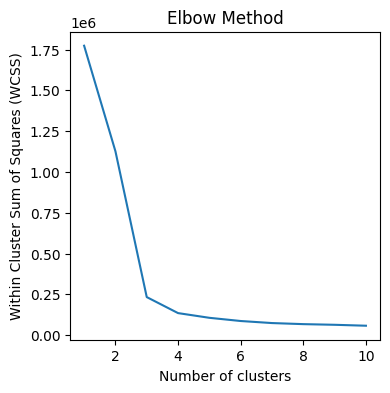

In [54]:
# Determine optimal cluster number with elbow method
X = data_reduced

wcss = []

for i in range(1, 11):
    model = KMeans(n_clusters = i,
                    init = 'k-means++',                 # Initialization method for kmeans
                    n_init = "auto",                        # Choose how often algorithm will run with different centroid
                    random_state = 0)                   # Choose random state for reproducibility
    model.fit(X)
    wcss.append(model.inertia_)

# Show Elbow plot
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')                               # Set plot title
plt.xlabel('Number of clusters')                        # Set x axis name
plt.ylabel('Within Cluster Sum of Squares (WCSS)')      # Set y axis name
plt.show()

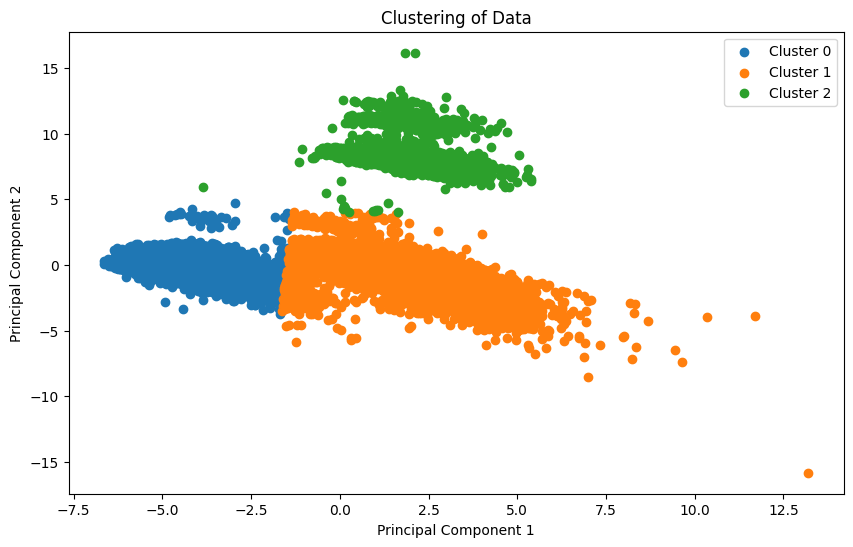

In [55]:
# %%
# Optimal cluster size seems to be 4
optimal_k = 3
kmeans = KMeans(n_clusters=optimal_k, n_init="auto")

clean_data['Cluster'] = kmeans.fit_predict(X)


# Visualize the clusters
plt.figure(figsize=(10, 6))
for cluster in sorted(clean_data['Cluster'].unique()):
    plt.scatter(data_reduced[clean_data['Cluster'] == cluster, 0], data_reduced[clean_data['Cluster'] == cluster, 1], label=f'Cluster {cluster}')

plt.title('Clustering of Data')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

In [ ]:
# # # %%
profile = ProfileReport(clean_data, title="Home Insurance Profiling Report")
profile.to_notebook_iframe()

In [ ]:
# %%
clean_data.shape

# Load your dataset
# Assuming 'clean_data' is your DataFrame and it's already loaded.
# clean_data = pd.read_csv('path_to_your_file.csv')

# List of add-on columns, assumed to be boolean
addon_columns = [
    'LEGAL_ADDON_PRE_REN', 'LEGAL_ADDON_POST_REN',
    'HOME_EM_ADDON_PRE_REN', 'HOME_EM_ADDON_POST_REN',
    'GARDEN_ADDON_PRE_REN', 'GARDEN_ADDON_POST_REN',
    'KEYCARE_ADDON_PRE_REN', 'KEYCARE_ADDON_POST_REN',
    'HP1_ADDON_PRE_REN', 'HP1_ADDON_POST_REN',
    'HP2_ADDON_PRE_REN', 'HP2_ADDON_POST_REN',
    'HP3_ADDON_PRE_REN', 'HP3_ADDON_POST_REN'
]

# # Convert boolean columns to integers (True=1, False=0) and sum them
# clean_data['TotalAddOns'] = clean_data[addon_columns].astype(int).sum(axis=1)

# # Now 'TotalAddOns' will have the sum of all add-on variables for each row/customer
# print(clean_data[['TotalAddOns']].describe())


# %%

In [56]:
# Assuming your DataFrame is already loaded into `clean_data`
# Loop through each row and calculate the sum based on "PRE" and "POST" conditions
def calculate_addons(row, addon_columns):
    total = 0
    for col in addon_columns:
        if "PRE" in col:
            # Check if the value is True/1; multiply by 1 if True
            total += 1 if row[col] else 0
        elif "POST" in col:
            # Check if the value is True/1; multiply by 0.5 if True
            total += 0.5 if row[col] else 0
    return total

# Apply the function to each row
total_addons = clean_data.apply(calculate_addons, addon_columns=addon_columns, axis=1)

# Display the DataFrame to verify the new column
print(total_addons.describe())

count    188074.000000
mean          1.481696
std           1.284153
min           0.000000
25%           0.000000
50%           1.500000
75%           2.000000
max           7.500000
dtype: float64


In [ ]:
clean_data['conversion_indicator'] = np.where(total_addons < 2, 0, 1)
clean_data['conversion_indicator'].value_counts()
# %%
# Replace 'target_column' with the name of your target variable
X = clean_data.drop(['conversion_indicator',"Cluster"], axis=1)
y = clean_data['conversion_indicator']

In [ ]:
#%% remove addon features to remove clues that the model can use to guess; also it is non-trivial to calculate these addons at inference time since it will be unknown, particularly for add ons post renewal.
cols_to_keep = [col for col in X.columns if col not in addon_columns]
X = X[cols_to_keep]
# %%
# split data into training and testing sets

# Initial split into training + validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Second split into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42, stratify=y_train_val)

In [ ]:
#%% use flaml for automl
from flaml import AutoML
automl = AutoML()
automl_settings = {
    "time_budget": 300,  # Time budget in seconds
    "task": 'classification',  # or 'regression', depending on your task
    "metric": 'f1',  # Evaluation metric, e.g., 'f1-score' for classification tasks
    "estimator_list": ['rf', 'lgbm', 'xgboost'],
}
automl.fit(X_train=X_train, y_train=y_train, X_val=X_val, y_val=y_val, **automl_settings)
print(automl.best_config)

In [ ]:
# %% eval
y_proba = automl.predict_proba(X_test)

y_pred = np.where(y_proba[:, 1] >= 0.5, 1, 0)
print(classification_report(y_pred=y_pred, y_true=y_test))

In [48]:
# Assuming automl is your FLAML AutoML instance and X_train is your training dataset
best_model = automl.model
feature_importances = best_model.feature_importances_
feature_names = X_train.columns.values
importances = pd.Series(feature_importances, index=feature_names)

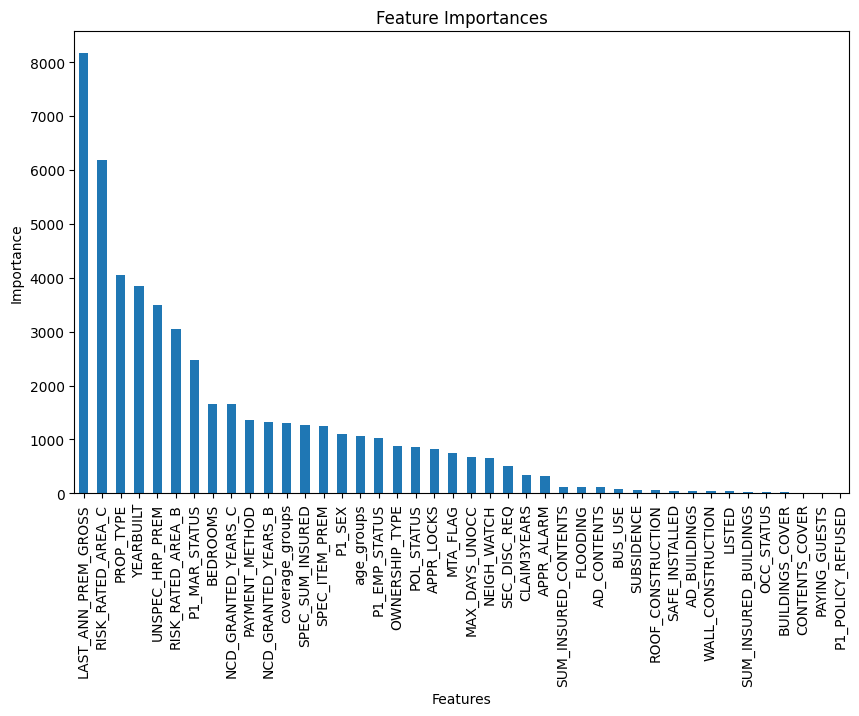

In [49]:
# Sort the feature importances in descending order
sorted_importances = importances.sort_values(ascending=False)

# Plot
plt.figure(figsize=(10, 6))
sorted_importances.plot(kind='bar')
plt.title('Feature Importances')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.show()

In [ ]:
# rfe -> recursive feature elimination
# model = LGBMClassifier(**automl.best_config)
# rfe = RFECV(estimator=model, min_features_to_select=5, verbose=1)
# rfe = rfe.fit(X_train, y_train)

In [ ]:
# selected_features = pd.Series(rfe.support_, index=X.columns)
# selected_features = selected_features[selected_features == True].index.tolist()
# print(selected_features)

In [ ]:
model = LGBMClassifier(**automl.best_config)
model.fit(X_train, y_train)

In [ ]:
import pickle

In [ ]:
pickle.dump(model, open("model.sav", "wb"))

In [ ]:
# %% eval
y_proba = model.predict_proba(X_test)

y_pred = np.where(y_proba[:, 1] >= 0.5, 1, 0)
print(classification_report(y_pred=y_pred, y_true=y_test))

In [ ]:
explainer = shap.TreeExplainer(model)
explanation = explainer(X_test)

shap_values = explanation.values
# make sure the SHAP values add up to marginal predictions
np.abs(shap_values.sum(axis=1) + explanation.base_values - y_pred).max()

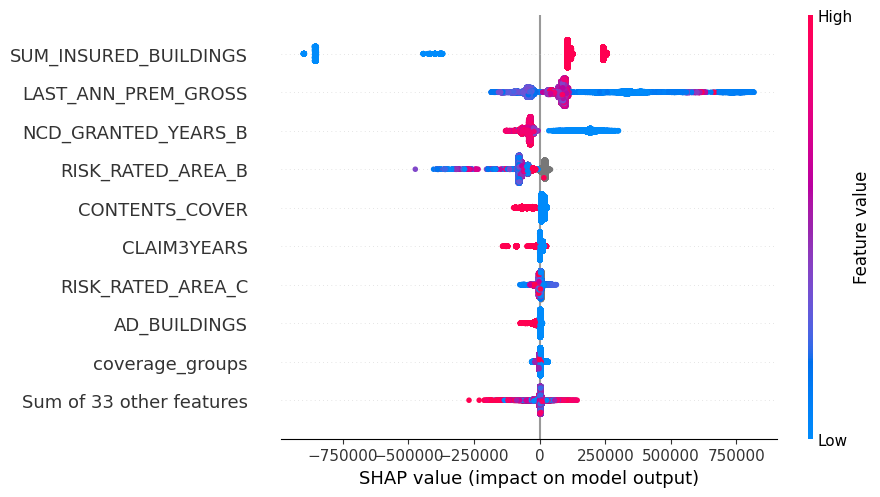

In [47]:
shap.plots.beeswarm(explanation)

In [ ]:
model.save_model('model.txt')